# 置信度分布误差
### Confident Distribution Error 




### 加载模型推理图片获得预测结果


In [ ]:
# 使用不确定性度量模块 - 空间遮挡率
# 该模型在桉树数据集上完成监督训练
!python -m sual.inference.detector \
    work_dirs\faster-rcnn_coco_100\faster-rcnn_coco_100.py \
    work_dirs\faster-rcnn_coco_100\epoch_20.pth \
    ./data/Eucalyptus_canopy/test20172017 \
    --device cuda:0 \
    --batch-size 8 \
    --num-workers 4 \
    --use-fp16 \
    --output-dir CDE_TEST/cde_metric_cannoy/ \
    --score-thr 0.4 \
    --nms-thr 0.3 \
    --max-det 100 \
    --uncertainty-methods sor \
    --vis-scale 1.0

### 加载每一张图片推理结果，可视化置信度分布

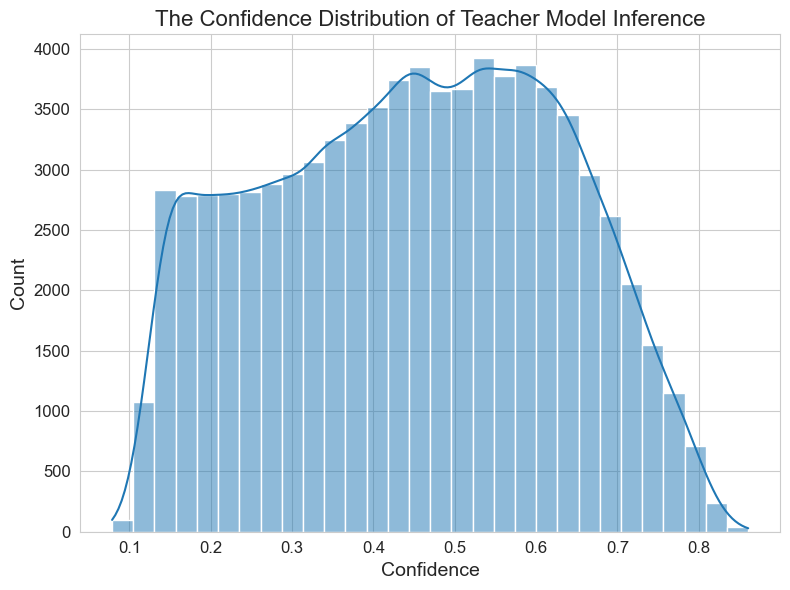

In [2]:
# # bash
# # command prompt
# !python tools/analyze_confidence_distribution.py CDE_TEST\\20241201_022542\\results

from tools.analyze_confidence_distribution import traverse_and_extract_scores,plot_histogram

folder_path = 'CDE_TEST\\20241201_022542\\results'
scores = traverse_and_extract_scores(folder_path)
plot_histogram(scores)

## CDE test metric

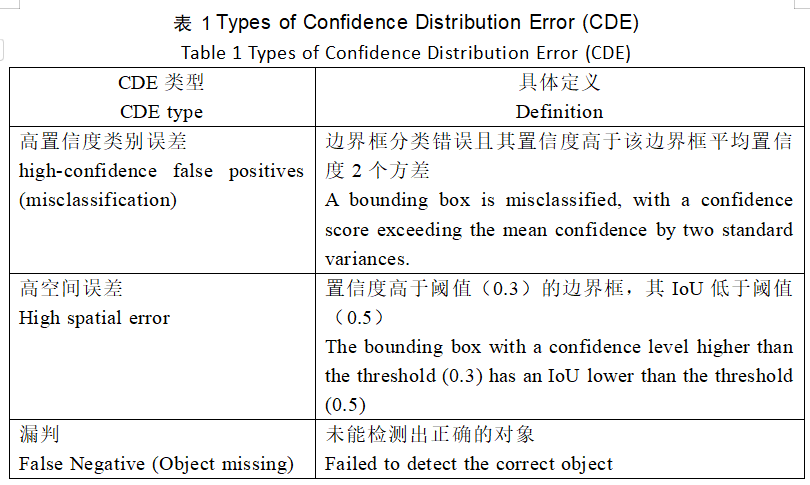

### 创建不同规模的coco数据集 数量分别为100 400 500 700 1000 1100 1400 1500 1700


In [ ]:
# Batch processing
!generate_datasets.bat

In [ ]:
# single processing
!python tools/prepare_supervised_learning_dataset.py \
--source-root data/coco \
--output-root data \
--num-images 200 \
--seed 42

### 验证coco数据集的格式

In [ ]:
!python tools/verify_coco_dataset.py data

### 计算cde python 调用

In [ ]:
import json
import numpy as np
from pathlib import Path
from typing import Dict, List
import torch
from mmengine.config import Config
from sual.inference.detector import DetectionInference

class CDEAnalyzer:
    def __init__(
            self,
            config_file: str,
            checkpoint_file: str,
            conf_thresh: float = 0.3,
            iou_thresh: float = 0.5
    ):
        self.conf_thresh = conf_thresh
        self.iou_thresh = iou_thresh
        
        # 初始化推理器
        self.detector = DetectionInference(
            config_file=config_file,
            checkpoint_file=checkpoint_file,
            output_dir='cde_outputs',
            enable_uncertainty=False
        )
        
        # 加载配置
        self.cfg = Config.fromfile(config_file)
    
    def calculate_iou(self, box1: np.ndarray, box2: List[float]) -> float:
        """计算两个边界框的IoU"""
        box2 = [box2[0], box2[1], box2[0] + box2[2], box2[1] + box2[3]]
        x1 = max(box1[0], box2[0])
        y1 = max(box1[1], box2[1])
        x2 = min(box1[2], box2[2])
        y2 = min(box1[3], box2[3])
        
        if x2 < x1 or y2 < y1:
            return 0.0
            
        intersection = (x2 - x1) * (y2 - y1)
        box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
        box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
        union = box1_area + box2_area - intersection
        
        return intersection / union if union > 0 else 0.0

    def analyze_prediction(self, pred_result: Dict, gt_boxes: List[Dict]) -> Dict[str, List[Dict]]:
        """分析单张图片的预测结果"""
        errors = {
            'high_conf_misclass': [],
            'high_spatial_error': [],
            'false_negative': []
        }
        
        print(f"\nGround truth boxes数量: {len(gt_boxes)}")
        
        if not pred_result or 'pred_instances' not in pred_result:
            print("未找到预测结果，所有GT框判定为漏标")
            for gt in gt_boxes:
                errors['false_negative'].append({'gt': gt})
            return errors

        pred_instances = pred_result['pred_instances']
        pred_bboxes = pred_instances.bboxes.cpu().numpy()
        pred_scores = pred_instances.scores.cpu().numpy()
        pred_labels = pred_instances.labels.cpu().numpy()

        # 筛选置信度大于阈值的框
        confidence_threshold = 0.5  # 降低置信度阈值
        indices = pred_scores > confidence_threshold

        # 使用筛选后的预测结果
        filtered_bboxes = pred_bboxes[indices]
        filtered_scores = pred_scores[indices]
        filtered_labels = pred_labels[indices]

        print(f"原始预测框数量: {len(pred_bboxes)}")
        print(f"筛选后预测框数量: {len(filtered_bboxes)}")
        print(f"筛选后预测得分数量: {len(filtered_scores)}")
        print(f"筛选后预测标签数量: {len(filtered_labels)}")

        if len(filtered_scores) > 0:
            mean_conf = np.mean(filtered_scores)
            std_conf = np.std(filtered_scores)
            print(f"平均置信度: {mean_conf:.3f}")
            print(f"置信度标准差: {std_conf:.3f}")
        else:
            mean_conf = std_conf = 0
            print("没有高置信度的预测框")
        
        for gt_idx, gt in enumerate(gt_boxes):
            print(f"\n分析第 {gt_idx+1} 个ground truth box:")
            print(f"GT box: {gt['bbox']}")
            print(f"GT category: {gt['category_id']}")
            
            gt_bbox = gt['bbox']
            gt_area = gt_bbox[2] * gt_bbox[3]
            best_iou = 0
            best_pred_idx = -1
            is_completely_contained = False
            
            # 如果筛选后没有预测框，直接判定为漏标
            if len(filtered_bboxes) == 0:
                errors['false_negative'].append({
                    'gt': gt,
                    'reason': 'no_predictions'
                })
                print("没有预测框，判定为漏标")
                continue
            
            # 使用筛选后的预测框进行匹配
            for pred_idx, (bbox, score, label) in enumerate(zip(filtered_bboxes, filtered_scores, filtered_labels)):
                iou = self.calculate_iou(bbox, gt_bbox)
                pred_area = (bbox[2] - bbox[0]) * (bbox[3] - bbox[1])
                
                print(f"与预测框 {pred_idx} 的IoU: {iou:.3f}, 置信度: {score:.3f}")
                
                gt_box_xyxy = [gt_bbox[0], gt_bbox[1], gt_bbox[0] + gt_bbox[2], gt_bbox[1] + gt_bbox[3]]
                is_contained = (bbox[0] <= gt_box_xyxy[0] and bbox[1] <= gt_box_xyxy[1] and
                              bbox[2] >= gt_box_xyxy[2] and bbox[3] >= gt_box_xyxy[3])
                
                if is_contained:
                    is_completely_contained = True
                    if pred_area <= gt_area * 1.25:
                        best_iou = iou
                        best_pred_idx = pred_idx
                        print(f"找到完全包含的预测框 {pred_idx}")
                        break
                
                if iou > best_iou:
                    best_iou = iou
                    best_pred_idx = pred_idx
                    print(f"更新最佳IoU: {best_iou:.3f}")
            
            print(f"最终最佳IoU: {best_iou:.3f}")
            
            # 判断各种错误类型
            if best_pred_idx >= 0:
                bbox = filtered_bboxes[best_pred_idx]
                score = filtered_scores[best_pred_idx]
                label = filtered_labels[best_pred_idx]
                pred_area = (bbox[2] - bbox[0]) * (bbox[3] - bbox[1])
                
                if best_iou >= 0.9:
                    if label != gt['category_id'] - 1 and score > mean_conf + 2 * std_conf:
                        errors['high_conf_misclass'].append({
                            'pred': {
                                'bbox': bbox.tolist(),
                                'score': float(score),
                                'label': int(label)
                            },
                            'gt': gt,
                            'iou': float(best_iou)
                        })
                        print("判定为高置信度错分类")
                elif 0.1 <= best_iou < 0.5:
                    errors['high_spatial_error'].append({
                        'pred': {
                            'bbox': bbox.tolist(),
                            'score': float(score),
                            'label': int(label)
                        },
                        'gt': gt,
                        'iou': float(best_iou)
                    })
                    print("判定为空间定位错误")
            
            # 修改后的漏标判定条件
            if best_iou < 0.1 or (best_pred_idx >= 0 and pred_area > gt_area * 1.25 and not is_completely_contained):
                errors['false_negative'].append({
                    'gt': gt,
                    'best_iou': float(best_iou),
                    'reason': 'low_iou' if best_iou < 0.1 else 'area_mismatch'
                })
                print("判定为漏标")
        
        return errors

    def analyze_folder(self, image_folder: str, annotation_path: str):
        """分析文件夹中的所有图片"""
        # 加载标注文件
        with open(annotation_path, 'r') as f:
            annotations = json.load(f)
        
        print(f"加载标注文件: {annotation_path}")
        print(f"总标注数量: {len(annotations['annotations'])}")
        
        # 创建图片ID到标注的映射
        image_id_to_annotations = {}
        for ann in annotations['annotations']:
            img_id = ann['image_id']
            if img_id not in image_id_to_annotations:
                image_id_to_annotations[img_id] = []
            image_id_to_annotations[img_id].append(ann)
        
        # 创建图片文件名到图片ID的映射
        filename_to_image_id = {
            img['file_name']: img['id']
            for img in annotations['images']
        }
        
        # 获取文件夹中的所有图片
        image_folder = Path(image_folder)
        image_files = list(image_folder.glob('*.jpg')) + list(image_folder.glob('*.png'))
        
        if not image_files:
            print(f"在 {image_folder} 中未找到图片文件")
            return
        
        print(f"找到 {len(image_files)} 张图片")
        
        # 进行推理
        inference_results = self.detector.inference(str(image_folder))
        
        # 用于累计所有图片的错误
        total_errors = {
            'high_conf_misclass': [],
            'high_spatial_error': [],
            'false_negative': []
        }
        
        # 处理每张图片的结果
        for image_path in image_files:
            image_name = image_path.name
            print(f"\n{'='*50}")
            print(f"处理图片: {image_name}")
            
            # 获取图片ID和对应的标注
            if image_name in filename_to_image_id:
                img_id = filename_to_image_id[image_name]
                image_annotations = image_id_to_annotations.get(img_id, [])
                print(f"图片ID: {img_id}")
                print(f"找到 {len(image_annotations)} 个标注")
            else:
                print(f"警告：在标注文件中未找到图片 {image_name} 的信息")
                image_annotations = []
            
            if image_name in inference_results:
                det_data_sample = inference_results[image_name]['result']
                pred_instances = det_data_sample.pred_instances
                
                # 分析推理结果
                errors = self.analyze_prediction(
                    {'pred_instances': pred_instances}, 
                    image_annotations
                )
                
                # 累计错误
                for error_type in total_errors:
                    total_errors[error_type].extend(errors[error_type])
                    
                # 打印当前图片的分析结果
                print(f"\n图片 {image_name} 的分析结果:")
                for error_type, error_list in errors.items():
                    print(f"{error_type}: {len(error_list)}")
            else:
                print(f"推理结果中未找到图像 {image_name}")
        
        # 打印总体统计信息
        print("\n" + "="*50)
        print("总体分析结果:")
        for error_type, error_list in total_errors.items():
            print(f"{error_type}: {len(error_list)} 个错误")
            
        # 保存分析结果
        output_path = Path('cde_analysis_results.json')
        with open(output_path, 'w', encoding='utf-8') as f:
            json.dump(total_errors, f, indent=2, ensure_ascii=False)
        print(f"\n分析结果已保存至: {output_path}")

def main():
    config = './work_dirs/deformable-detr_r50_16xb2-50e_coco/deformable-detr_r50_16xb2-50e_coco.py'
    checkpoint = './work_dirs/deformable-detr_r50_16xb2-50e_coco/epoch_50.pth'
    image_folder = "data/Eucalyptus_canopy/val2017"
    annotation_path = 'data/Eucalyptus_canopy/annotations/instances_val2017.json'
    
    analyzer = CDEAnalyzer(
        config_file=config,
        checkpoint_file=checkpoint,
        conf_thresh=0.3,  # 降低置信度阈值
        iou_thresh=0.5
    )
    analyzer.analyze_folder(image_folder, annotation_path)

if __name__ == '__main__':
    main()

### 批量创建输出路径

In [51]:
import os

def create_folders(base_path):
    """创建指定的文件夹"""
    folder_names = [100,200, 300, 500, 700, 900, 1100, 1500, 1700]
    for name in folder_names:
        folder_path = os.path.join(base_path, f"yolox_x_cannoy_{name}")
        try:
            os.makedirs(folder_path, exist_ok=True)
            print(f"Folder created: {folder_path}")
        except Exception as e:
            print(f"Error creating folder {folder_path}: {e}")

if __name__ == "__main__":
    base_directory = './CDE_TEST/visualization_cde/' # 修改为目标路径
    create_folders(base_directory)


Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_100
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_200
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_300
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_500
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_700
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_900
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_1100
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_1500
Folder created: ./CDE_TEST/visualization_cde/yolox_x_cannoy_1700


### python脚本计算cde

In [25]:
!python tools/analyze_cde.py \
    --config work_dirs\faster-rcnn_coco_200\faster-rcnn_coco_200.py \
    --checkpoint work_dirs\faster-rcnn_coco_200\epoch_18.pth \
    --image-folder data/coco/test2017 \
    --annotation data/coco/annotations/instances_test2017.json \
    --conf-thresh 0.3 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_cannoy\fasterrcnn_cannoy_200\cde_200_analysis_results.json

Loads checkpoint by local backend from path: work_dirs\faster-rcnn_coco_200\epoch_18.pth
enable_uncertainty value: False
2024-12-16 14:30:50 - INFO - 初始化CDEAnalyzer完成
2024-12-16 14:30:50 - INFO - 配置文件: work_dirs\faster-rcnn_coco_200\faster-rcnn_coco_200.py
2024-12-16 14:30:50 - INFO - 检查点文件: work_dirs\faster-rcnn_coco_200\epoch_18.pth
2024-12-16 14:30:50 - INFO - 置信度阈值: 0.3
2024-12-16 14:30:50 - INFO - IoU阈值: 0.5
2024-12-16 14:30:50 - INFO - 开始分析文件夹: data/coco/test2017
2024-12-16 14:30:50 - INFO - 加载标注文件: data/coco/annotations/instances_test2017.json
2024-12-16 14:30:50 - INFO - 总标注数量: 1739
2024-12-16 14:30:50 - INFO - 找到 264 张图片
2024-12-16 14:31:08 - INFO - 
2024-12-16 14:31:08 - INFO - 处理图片: 000000004665.jpg
2024-12-16 14:31:08 - INFO - 图片ID: 4665
2024-12-16 14:31:08 - INFO - 找到 4 个标注
2024-12-16 14:31:08 - INFO - 
Ground truth boxes数量: 4
2024-12-16 14:31:08 - INFO - 平均置信度: 0.167
2024-12-16 14:31:08 - INFO - 置信度标准差: 0.166
2024-12-16 14:31:08 - INFO - 
分析第 1 个ground truth box:
2024-12-


Processing images: 100%|██████████| 264/264 [00:18<00:00, 14.38it/s]


In [21]:
!python tools/analyze_cde.py \
    --config work_dirs\yolox_x_coco_900\yolox_x_coco_900.py \
    --checkpoint work_dirs\yolox_x_coco_900\epoch_15.pth \
    --image-folder data/coco/test2017 \
    --annotation data/coco/annotations/instances_test2017.json \
    --conf-thresh 0.3 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_cannoy\yolox_x_cannoy_900\cde_900_analysis_results.json

Loads checkpoint by local backend from path: work_dirs\yolox_x_coco_900\epoch_15.pth
enable_uncertainty value: False
2024-12-16 13:29:48 - INFO - 初始化CDEAnalyzer完成
2024-12-16 13:29:48 - INFO - 配置文件: work_dirs\yolox_x_coco_900\yolox_x_coco_900.py
2024-12-16 13:29:48 - INFO - 检查点文件: work_dirs\yolox_x_coco_900\epoch_15.pth
2024-12-16 13:29:48 - INFO - 置信度阈值: 0.3
2024-12-16 13:29:48 - INFO - IoU阈值: 0.5
2024-12-16 13:29:48 - INFO - 开始分析文件夹: data/coco/test2017
2024-12-16 13:29:48 - INFO - 加载标注文件: data/coco/annotations/instances_test2017.json
2024-12-16 13:29:48 - INFO - 总标注数量: 1739
2024-12-16 13:29:48 - INFO - 找到 264 张图片
2024-12-16 13:30:16 - INFO - 
2024-12-16 13:30:16 - INFO - 处理图片: 000000004665.jpg
2024-12-16 13:30:16 - INFO - 图片ID: 4665
2024-12-16 13:30:16 - INFO - 找到 4 个标注
2024-12-16 13:30:16 - INFO - 
Ground truth boxes数量: 4
2024-12-16 13:30:16 - INFO - 平均置信度: 0.024
2024-12-16 13:30:16 - INFO - 置信度标准差: 0.011
2024-12-16 13:30:16 - INFO - 
分析第 1 个ground truth box:
2024-12-16 13:30:16 - IN


Processing images: 100%|██████████| 264/264 [00:28<00:00,  9.34it/s]



2024-12-16 13:30:16 - INFO - high_spatial_error: 0
2024-12-16 13:30:16 - INFO - false_negative: 5
2024-12-16 13:30:16 - INFO - 
2024-12-16 13:30:16 - INFO - 处理图片: 000000006748.jpg
2024-12-16 13:30:16 - INFO - 图片ID: 6748
2024-12-16 13:30:16 - INFO - 找到 2 个标注
2024-12-16 13:30:16 - INFO - 
Ground truth boxes数量: 2
2024-12-16 13:30:16 - INFO - 平均置信度: 0.017
2024-12-16 13:30:16 - INFO - 置信度标准差: 0.006
2024-12-16 13:30:16 - INFO - 
分析第 1 个ground truth box:
2024-12-16 13:30:16 - INFO - 
分析第 2 个ground truth box:
2024-12-16 13:30:16 - INFO - 
图片 000000006748.jpg 的分析结果:
2024-12-16 13:30:16 - INFO - high_conf_misclass: 0
2024-12-16 13:30:16 - INFO - high_spatial_error: 0
2024-12-16 13:30:16 - INFO - false_negative: 0
2024-12-16 13:30:16 - INFO - 
2024-12-16 13:30:16 - INFO - 处理图片: 000000006749.jpg
2024-12-16 13:30:16 - INFO - 图片ID: 6749
2024-12-16 13:30:16 - INFO - 找到 4 个标注
2024-12-16 13:30:16 - INFO - 
Ground truth boxes数量: 4
2024-12-16 13:30:16 - INFO - 平均置信度: 0.019
2024-12-16 13:30:16 - INFO - 置

### python脚本批量计算cde

In [18]:
import os
import subprocess

def batch_analyze_cde(script_path, config_template, checkpoint_template, image_folder, annotation_file, output_folder, dataset_sizes, conf_thresh=0.3, iou_thresh=0.5):
    """
    批量运行 analyze_cde.py 脚本。

    :param script_path: analyze_cde.py 脚本的路径
    :param config_template: 配置文件路径模板，包含 {num} 占位符
    :param checkpoint_template: 检查点文件路径模板，包含 {num} 占位符
    :param image_folder: 图像文件夹路径
    :param annotation_file: 标注文件路径
    :param output_folder: 输出文件夹路径模板，包含 {num} 占位符
    :param dataset_sizes: 数据集规模列表
    :param conf_thresh: 置信度阈值
    :param iou_thresh: IOU 阈值
    """
    for num in dataset_sizes:
        config_path = config_template.format(num=num)
        checkpoint_path = checkpoint_template.format(num=num)
        output_path = os.path.join(output_folder.format(num=num), f"cde_{num}_analysis_results.json")
        os.makedirs(os.path.dirname(output_path), exist_ok=True)

        # 检查配置文件和检查点是否存在
        if not os.path.exists(config_path):
            print(f"Config file not found: {config_path}. Skipping this dataset size.")
            continue
        if not os.path.exists(checkpoint_path):
            print(f"Checkpoint file not found: {checkpoint_path}. Skipping this dataset size.")
            continue

        command = [
            "python", script_path,
            "--config", config_path,
            "--checkpoint", checkpoint_path,
            "--image-folder", image_folder,
            "--annotation", annotation_file,
            "--conf-thresh", str(conf_thresh),
            "--iou-thresh", str(iou_thresh),
            "--output", output_path
        ]

        print(f"Running: {' '.join(command)}")
        try:
            subprocess.run(command, check=True)
        except subprocess.CalledProcessError as e:
            print(f"Error running command for dataset size {num}: {e}")
            continue  # 跳过当前任务，继续下一个任务

# 示例用法
script_path = "tools/analyze_cde.py"
config_template = "work_dirs/faster-rcnn_coco_{num}/faster-rcnn_coco_{num}.py"
checkpoint_template = "work_dirs/faster-rcnn_coco_{num}/epoch_20.pth"
image_folder = "data/coco/test2017"
annotation_file = "data/coco/annotations/instances_test2017.json"
output_folder = "CDE_TEST/cde_metric_cannoy/fasterrcnn_cannoy_{num}"

dataset_sizes = [100, 200, 300, 500, 700, 900, 1100, 1500, 1700]

batch_analyze_cde(
    script_path=script_path,
    config_template=config_template,
    checkpoint_template=checkpoint_template,
    image_folder=image_folder,
    annotation_file=annotation_file,
    output_folder=output_folder,
    dataset_sizes=dataset_sizes,
    conf_thresh=0.3,
    iou_thresh=0.5
)


Running: python tools/analyze_cde.py --config work_dirs/faster-rcnn_coco_100/faster-rcnn_coco_100.py --checkpoint work_dirs/faster-rcnn_coco_100/epoch_20.pth --image-folder data/coco/test2017 --annotation data/coco/annotations/instances_test2017.json --conf-thresh 0.3 --iou-thresh 0.5 --output CDE_TEST/cde_metric_cannoy/fasterrcnn_cannoy_100\cde_100_analysis_results.json
Running: python tools/analyze_cde.py --config work_dirs/faster-rcnn_coco_200/faster-rcnn_coco_200.py --checkpoint work_dirs/faster-rcnn_coco_200/epoch_20.pth --image-folder data/coco/test2017 --annotation data/coco/annotations/instances_test2017.json --conf-thresh 0.3 --iou-thresh 0.5 --output CDE_TEST/cde_metric_cannoy/fasterrcnn_cannoy_200\cde_200_analysis_results.json
Running: python tools/analyze_cde.py --config work_dirs/faster-rcnn_coco_300/faster-rcnn_coco_300.py --checkpoint work_dirs/faster-rcnn_coco_300/epoch_20.pth --image-folder data/coco/test2017 --annotation data/coco/annotations/instances_test2017.json -

### cde结果可视化（漏判 ，高空间误差，高置信度类别误差）

已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_34.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_35.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_36.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_37.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_38.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_40.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0108_Cropped_45.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0114_Cropped_36.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0114_Cropped_45.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0114_Cropped_55.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0186_Cropped_7.jpg
已保存可视化结果: CDE_TEST\visualization_cde\yolox_x_cannoy_1700\viz_DJI_0

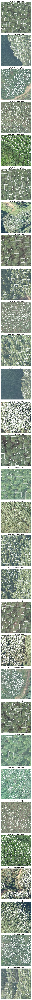

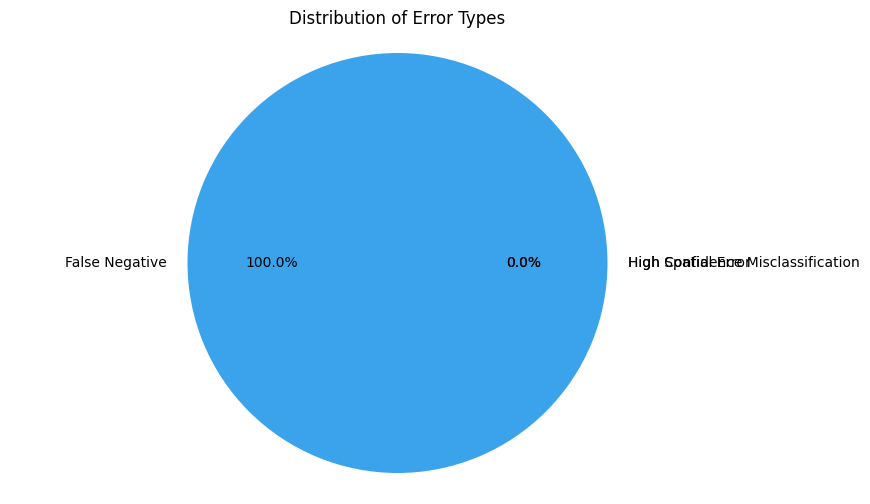

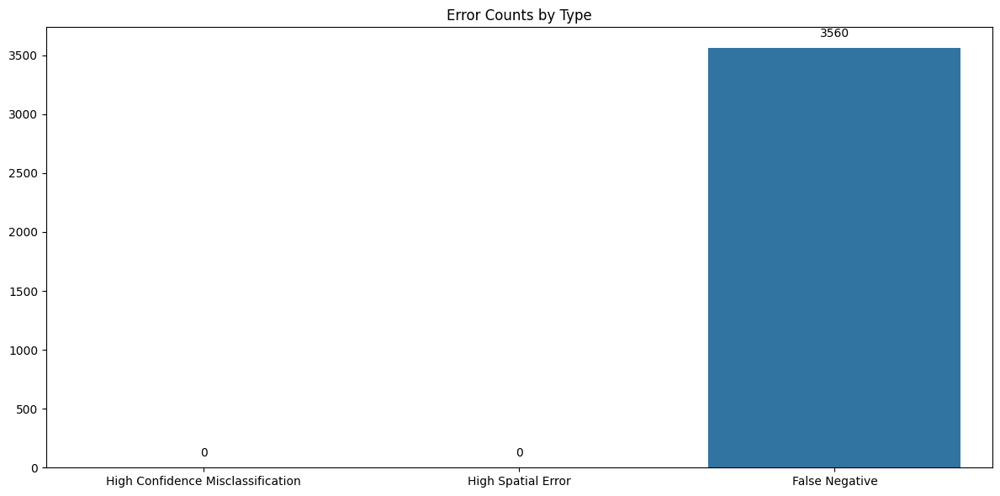

In [60]:
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import random
import pandas as pd
import seaborn as sns

def load_annotations(annotation_path):
    """加载标注文件并创建ID到文件名的映射"""
    with open(annotation_path, 'r') as f:
        annotations = json.load(f)
    
    # 创建图片ID到文件名的映射
    id_to_filename = {
        img['id']: img['file_name'] 
        for img in annotations['images']
    }
    
    return annotations, id_to_filename

def draw_box(image, box, color, label=None, thickness=4):
    """绘制边界框和标签"""
    x1, y1, w, h = map(int, box)
    x2, y2 = x1 + w, y1 + h
    cv2.rectangle(image, (x1, y1), (x2, y2), color, thickness)
    if label:
        # 确保文本完全在图像内
        text_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
        if y1 - text_size[1] - 4 > 0:
            y_text = y1 - 4
        else:
            y_text = y1 + text_size[1] + 4
        cv2.putText(image, label, (x1, y_text), 
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

def visualize_errors(image_folder, results_file, annotation_path, output_folder='visualization_results'):
    """可视化CDE分析结果"""
    # 加载分析结果
    with open(results_file, 'r') as f:
        results = json.load(f)
    
    # 加载标注文件
    annotations, id_to_filename = load_annotations(annotation_path)
    
    # 创建输出文件夹
    output_folder = Path(output_folder)
    output_folder.mkdir(parents=True, exist_ok=True)
    
    # 为不同类型的错误定义颜色
    colors = {
        'high_conf_misclass': (255, 0, 0),    # 红色
        'high_spatial_error': (0, 255, 0),    # 绿色
        'false_negative': (0, 0, 255),        # 蓝色
        'ground_truth': (255, 255, 255)       # 白色
    }
    
    # 缓存处理过的图片
    processed_images = {}
    
    # 记录所有需要绘制的框
    boxes_to_draw = {}
    
    # 处理每种类型的错误
    for error_type, error_list in results.items():
        for error in error_list:
            if 'gt' in error and 'image_id' in error['gt']:
                image_id = error['gt']['image_id']
                if image_id not in id_to_filename:
                    print(f"找不到图片ID {image_id} 对应的文件名")
                    continue
                
                filename = id_to_filename[image_id]
                image_path = Path(image_folder) / filename
                
                if not image_path.exists():
                    print(f"找不到图片: {image_path}")
                    continue
                
                if image_id not in processed_images:
                    image = cv2.imread(str(image_path))
                    if image is None:
                        print(f"无法读取图片: {image_path}")
                        continue
                    processed_images[image_id] = image
                    boxes_to_draw[image_id] = []
                
                # 添加框到列表中
                if 'pred' in error:
                    pred_box = error['pred']['bbox']
                    score = error['pred'].get('score', 0)
                    label = f"{error_type[:4]}:{score:.2f}"
                    boxes_to_draw[image_id].append((pred_box, colors[error_type], label, 4))
                
                if 'gt' in error:
                    gt_box = error['gt']['bbox']
                    boxes_to_draw[image_id].append((gt_box, colors['ground_truth'], 'GT', 1))
    
    # 绘制所有框并保存图片
    for image_id, image in processed_images.items():
        for box, color, label, thickness in boxes_to_draw[image_id]:
            draw_box(image, box, color, label, thickness)
        filename = id_to_filename[image_id]
        output_path = output_folder / f"viz_{filename}"
        cv2.imwrite(str(output_path), image)
        print(f"已保存可视化结果: {output_path}")

# 显示一些随机示例
def show_random_examples(output_folder, num_examples=30):
    """随机显示一些可视化结果"""
    output_folder = Path(output_folder)
    viz_files = list(output_folder.glob('viz_*.jpg'))
    
    if not viz_files:
        print("没有找到可视化结果")
        return
    
    num_examples = min(num_examples, len(viz_files))
    selected_files = random.sample(viz_files, num_examples)
    
    plt.figure(figsize=(15, 5*num_examples))
    for i, file in enumerate(selected_files, 1):
        img = cv2.imread(str(file))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(num_examples, 1, i)
        plt.imshow(img)
        plt.title(file.name)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

def plot_error_statistics(results_file, output_folder):
    """统计错误类型并绘制柱状图和饼图"""
    with open(results_file, 'r') as f:
        results = json.load(f)

    error_counts = {
        'High Confidence Misclassification': len(results.get('high_conf_misclass', [])),
        'High Spatial Error': len(results.get('high_spatial_error', [])),
        'False Negative': len(results.get('false_negative', []))
    }

    # 创建饼图
    plt.figure(figsize=(10, 8))
    plt.pie(error_counts.values(), 
            labels=error_counts.keys(),
            autopct='%1.1f%%',
            colors=sns.color_palette("husl", 3))
    plt.title('Distribution of Error Types')
    plt.axis('equal')
    plt.savefig(Path(output_folder) / 'error_distribution_pie_chart.png')
    plt.show()

    # 创建柱状图
    plt.figure(figsize=(12, 6))
    sns.barplot(x=list(error_counts.keys()), y=list(error_counts.values()))
    plt.title('Error Counts by Type')
    plt.xticks(rotation=0)

    # 在柱状图上标注数量
    for i, count in enumerate(error_counts.values()):
        plt.text(i, count + max(error_counts.values()) * 0.02, str(count), 
                 ha='center', va='bottom', fontsize=10, color='black')

    plt.tight_layout()
    plt.savefig(Path(output_folder) / 'error_counts_bar_chart.png')
    plt.show()

# 使用示例
image_folder = "data/Eucalyptus_canopy/test2017"
results_file = "CDE_TEST/cde_metric_cannoy/fasterrcnn_cannoy_100/cde_100_analysis_results.json"
annotation_path = "data/Eucalyptus_canopy/annotations/instances_test2017.json"
output_folder = 'CDE_TEST/visualization_cde/fasterrcnn_cannoy_100'

# 执行可视化
visualize_errors(image_folder, results_file, annotation_path, output_folder)

# 显示统计信息和随机示例
print("\n错误统计:")
print("-" * 50)
with open(results_file, 'r') as f:
    results = json.load(f)
    for error_type, error_list in results.items():
        print(f"{error_type}: {len(error_list)} 个错误")

show_random_examples(output_folder)

# 绘制统计图表
plot_error_statistics(results_file, output_folder)


In [3]:
import json

def count_false_negatives(json_file):
    """计算 JSON 文件中 false_negative 键的长度"""
    with open(json_file, 'r') as f:
        data = json.load(f)
    false_negative_count = len(data.get('false_negative', []))
    print(f"False Negative 键的长度: {false_negative_count}")

# 使用示例
json_file = "CDE_TEST\cde_metric_cannoy\\fasterrcnn_cannoy_700\cde_700_analysis_results.json"
count_false_negatives(json_file)


False Negative 键的长度: 3595


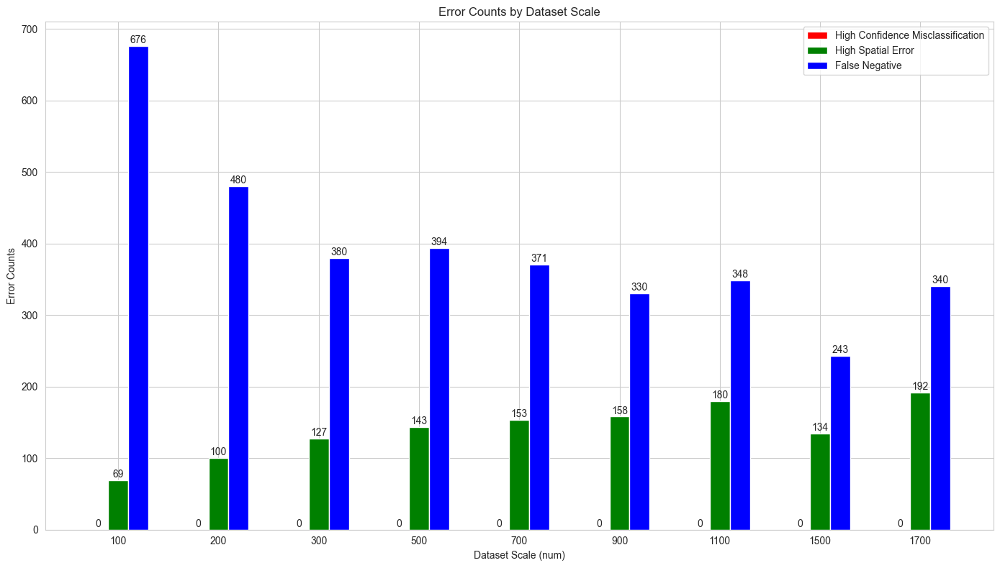

In [26]:
import json
import os
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

def collect_error_statistics(root_path, datasets):
    """统计每个数据集中的错误类型数量"""
    stats = {'num': [], 'high_conf_misclass': [], 'high_spatial_error': [], 'false_negative': []}
    for num in datasets:
        dataset_path = Path(root_path) / f"fasterrcnn_cannoy_{num}" / f"cde_{num}_analysis_results.json"
        if not dataset_path.exists():
            print(f"数据集 {num} 的 JSON 文件不存在: {dataset_path}")
            continue

        with open(dataset_path, 'r') as f:
            results = json.load(f)
        
        stats['num'].append(num)
        stats['high_conf_misclass'].append(len(results.get('high_conf_misclass', [])))
        stats['high_spatial_error'].append(len(results.get('high_spatial_error', [])))
        stats['false_negative'].append(len(results.get('false_negative', [])))
    
    return stats

def plot_error_statistics(stats, output_file):
    """绘制统计柱状图"""
    plt.figure(figsize=(14, 8))
    bar_width = 0.2
    x = range(len(stats['num']))

    # 绘制每种错误的柱状图
    plt.bar([p - bar_width for p in x], stats['high_conf_misclass'], 
            bar_width, label='High Confidence Misclassification', color='red')
    plt.bar(x, stats['high_spatial_error'], 
            bar_width, label='High Spatial Error', color='green')
    plt.bar([p + bar_width for p in x], stats['false_negative'], 
            bar_width, label='False Negative', color='blue')

    # 添加数量标注
    for i, num in enumerate(stats['num']):
        plt.text(i - bar_width, stats['high_conf_misclass'][i] + 1, 
                 str(stats['high_conf_misclass'][i]), ha='center', va='bottom', fontsize=10)
        plt.text(i, stats['high_spatial_error'][i] + 1, 
                 str(stats['high_spatial_error'][i]), ha='center', va='bottom', fontsize=10)
        plt.text(i + bar_width, stats['false_negative'][i] + 1, 
                 str(stats['false_negative'][i]), ha='center', va='bottom', fontsize=10)

    # 设置图表信息
    plt.xticks(x, stats['num'])
    plt.xlabel('Dataset Scale (num)')
    plt.ylabel('Error Counts')
    plt.title('Error Counts by Dataset Scale')
    plt.legend()
    plt.tight_layout()
    plt.savefig(output_file)
    plt.show()

# 使用示例
root_path = "CDE_TEST/cde_metric_cannoy"
datasets = [100, 200, 300, 500, 700, 900, 1100, 1500, 1700]
output_file = "CDE_TEST/cde_metric_cannoy/fferror_statistics_bar_chart.png"
# 统计错误
stats = collect_error_statistics(root_path, datasets)

# 绘制统计图
plot_error_statistics(stats, output_file)


### 主动学习第一轮

In [3]:
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_1\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_1\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round1\fasterrcnn_round1_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_1\best_coco_bbox_mAP_epoch_2.pth
enable_uncertainty value: False
2024-12-23 20:18:07 - INFO - 初始化CDEAnalyzer完成
2024-12-23 20:18:07 - INFO - 配置文件: work_dirs\faster_rcnn_bamberg1024_al8\round_1\faster_rcnn_bamberg1024_al.py
2024-12-23 20:18:07 - INFO - 检查点文件: work_dirs\faster_rcnn_bamberg1024_al8\round_1\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:18:07 - INFO - 置信度阈值: 0.45
2024-12-23 20:18:07 - INFO - IoU阈值: 0.5
2024-12-23 20:18:07 - INFO - 开始分析文件夹: data/bamberg_coco1024/test2023
2024-12-23 20:18:07 - INFO - 加载标注文件: data\bamberg_coco1024\annotations\instances_tree_test2023.json
2024-12-23 20:18:07 - INFO - 总标注数量: 33160
2024-12-23 20:18:07 - INFO - 找到 3343 张图片
2024-12-23 20:25:40 - INFO - 
2024-12-23 20:25:40 - INFO - 处理图片: Hain_117_0.jpg
2024-12-23 20:25:40 - INFO - 图片ID: 0
2024-12-23 20:25:40 - INFO - 找到 10 个标注
2024-12-23 20:25:40 - INFO - 
Ground truth boxes数量: 10
2024-12-23 20:25:40 - INFO - 平均置


Processing images: 100%|██████████| 3343/3343 [07:32<00:00,  7.38it/s]



2024-12-23 20:25:43 - INFO - 找到 8 个标注
2024-12-23 20:25:43 - INFO - 
Ground truth boxes数量: 8
2024-12-23 20:25:43 - INFO - 平均置信度: 0.301
2024-12-23 20:25:43 - INFO - 置信度标准差: 0.156
2024-12-23 20:25:43 - INFO - 
分析第 1 个ground truth box:
2024-12-23 20:25:43 - INFO - 判定为高空间误差 (IoU: 0.473, 置信度: 0.382)
2024-12-23 20:25:43 - INFO - 
分析第 2 个ground truth box:
2024-12-23 20:25:43 - INFO - 
分析第 3 个ground truth box:
2024-12-23 20:25:43 - INFO - 
分析第 4 个ground truth box:
2024-12-23 20:25:43 - INFO - 
分析第 5 个ground truth box:
2024-12-23 20:25:43 - INFO - 
分析第 6 个ground truth box:
2024-12-23 20:25:43 - INFO - 
分析第 7 个ground truth box:
2024-12-23 20:25:43 - INFO - 判定为高空间误差 (IoU: 0.273, 置信度: 0.726)
2024-12-23 20:25:43 - INFO - 
分析第 8 个ground truth box:
2024-12-23 20:25:43 - INFO - 
图片 Hain_171_718.jpg 的分析结果:
2024-12-23 20:25:43 - INFO - high_conf_misclass: 0
2024-12-23 20:25:43 - INFO - high_spatial_error: 2
2024-12-23 20:25:43 - INFO - false_negative: 0
2024-12-23 20:25:43 - INFO - 
2024-12-23 20:25:43 

### 主动学习第二轮

In [4]:
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_2\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_2\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round2\fasterrcnn_round2_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_2\best_coco_bbox_mAP_epoch_2.pth
enable_uncertainty value: False
2024-12-23 20:27:13 - INFO - 初始化CDEAnalyzer完成
2024-12-23 20:27:13 - INFO - 配置文件: work_dirs\faster_rcnn_bamberg1024_al8\round_2\faster_rcnn_bamberg1024_al.py
2024-12-23 20:27:13 - INFO - 检查点文件: work_dirs\faster_rcnn_bamberg1024_al8\round_2\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:27:13 - INFO - 置信度阈值: 0.45
2024-12-23 20:27:13 - INFO - IoU阈值: 0.5
2024-12-23 20:27:13 - INFO - 开始分析文件夹: data/bamberg_coco1024/test2023
2024-12-23 20:27:13 - INFO - 加载标注文件: data\bamberg_coco1024\annotations\instances_tree_test2023.json
2024-12-23 20:27:13 - INFO - 总标注数量: 33160
2024-12-23 20:27:13 - INFO - 找到 3343 张图片
2024-12-23 20:34:13 - INFO - 
2024-12-23 20:34:13 - INFO - 处理图片: Hain_117_0.jpg
2024-12-23 20:34:13 - INFO - 图片ID: 0
2024-12-23 20:34:13 - INFO - 找到 10 个标注
2024-12-23 20:34:13 - INFO - 
Ground truth boxes数量: 10
2024-12-23 20:34:13 - INFO - 平均置


Processing images: 100%|██████████| 3343/3343 [06:59<00:00,  7.96it/s]


分析第 5 个ground truth box:
2024-12-23 20:34:14 - INFO - 
图片 Hain_155_239.jpg 的分析结果:
2024-12-23 20:34:14 - INFO - high_conf_misclass: 0
2024-12-23 20:34:14 - INFO - high_spatial_error: 1
2024-12-23 20:34:14 - INFO - false_negative: 0
2024-12-23 20:34:14 - INFO - 
2024-12-23 20:34:14 - INFO - 处理图片: Hain_155_240.jpg
2024-12-23 20:34:14 - INFO - 图片ID: 240
2024-12-23 20:34:14 - INFO - 找到 7 个标注
2024-12-23 20:34:14 - INFO - 
Ground truth boxes数量: 7
2024-12-23 20:34:14 - INFO - 平均置信度: 0.227
2024-12-23 20:34:14 - INFO - 置信度标准差: 0.214
2024-12-23 20:34:14 - INFO - 
分析第 1 个ground truth box:
2024-12-23 20:34:14 - INFO - 判定为漏检
2024-12-23 20:34:14 - INFO - 
分析第 2 个ground truth box:
2024-12-23 20:34:14 - INFO - 
分析第 3 个ground truth box:
2024-12-23 20:34:14 - INFO - 
分析第 4 个ground truth box:
2024-12-23 20:34:14 - INFO - 
分析第 5 个ground truth box:
2024-12-23 20:34:14 - INFO - 判定为漏检
2024-12-23 20:34:14 - INFO - 
分析第 6 个ground truth box:
2024-12-23 20:34:14 - INFO - 
分析第 7 个ground truth box:
2024-12-23 20:34

### 主动学习第三轮

In [13]:
# Round 3
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_3\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_3\best_coco_bbox_mAP_epoch_1.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round3\fasterrcnn_round3_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_3\best_coco_bbox_mAP_epoch_1.pth
enable_uncertainty value: False
2024-12-23 20:49:57 - INFO - 初始化CDEAnalyzer完成
2024-12-23 20:49:57 - INFO - 配置文件: work_dirs\faster_rcnn_bamberg1024_al8\round_3\faster_rcnn_bamberg1024_al.py
2024-12-23 20:49:57 - INFO - 检查点文件: work_dirs\faster_rcnn_bamberg1024_al8\round_3\best_coco_bbox_mAP_epoch_1.pth
2024-12-23 20:49:57 - INFO - 置信度阈值: 0.45
2024-12-23 20:49:57 - INFO - IoU阈值: 0.5
2024-12-23 20:49:57 - INFO - 开始分析文件夹: data/bamberg_coco1024/test2023
2024-12-23 20:49:57 - INFO - 加载标注文件: data\bamberg_coco1024\annotations\instances_tree_test2023.json
2024-12-23 20:49:57 - INFO - 总标注数量: 33160
2024-12-23 20:49:57 - INFO - 找到 3343 张图片
2024-12-23 20:56:50 - INFO - 
2024-12-23 20:56:50 - INFO - 处理图片: Hain_117_0.jpg
2024-12-23 20:56:50 - INFO - 图片ID: 0
2024-12-23 20:56:50 - INFO - 找到 10 个标注
2024-12-23 20:56:50 - INFO - 
Ground truth boxes数量: 10
2024-12-23 20:56:50 - INFO - 平均置


Processing images: 100%|██████████| 3343/3343 [06:52<00:00,  8.11it/s]


2024-12-23 20:56:50 - INFO - 找到 4 个标注
2024-12-23 20:56:50 - INFO - 
Ground truth boxes数量: 4
2024-12-23 20:56:50 - INFO - 平均置信度: 0.218
2024-12-23 20:56:50 - INFO - 置信度标准差: 0.234
2024-12-23 20:56:50 - INFO - 
分析第 1 个ground truth box:
2024-12-23 20:56:50 - INFO - 
分析第 2 个ground truth box:
2024-12-23 20:56:50 - INFO - 
分析第 3 个ground truth box:
2024-12-23 20:56:50 - INFO - 判定为高空间误差 (IoU: 0.400, 置信度: 0.823)
2024-12-23 20:56:50 - INFO - 
分析第 4 个ground truth box:
2024-12-23 20:56:50 - INFO - 判定为高空间误差 (IoU: 0.459, 置信度: 0.831)
2024-12-23 20:56:50 - INFO - 
图片 Hain_155_320.jpg 的分析结果:
2024-12-23 20:56:50 - INFO - high_conf_misclass: 0
2024-12-23 20:56:50 - INFO - high_spatial_error: 2
2024-12-23 20:56:50 - INFO - false_negative: 0
2024-12-23 20:56:50 - INFO - 
2024-12-23 20:56:50 - INFO - 处理图片: Hain_156_321.jpg
2024-12-23 20:56:50 - INFO - 图片ID: 321
2024-12-23 20:56:50 - INFO - 找到 4 个标注
2024-12-23 20:56:50 - INFO - 
Ground truth boxes数量: 4
2024-12-23 20:56:50 - INFO - 平均置信度: 0.222
2024-12-23 20:56

### 主动学习第四轮

In [15]:
# Round 4
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_4\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_4\best_coco_bbox_mAP_epoch_1.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round4\fasterrcnn_round4_results.json

^C


Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_4\best_coco_bbox_mAP_epoch_1.pth
enable_uncertainty value: False
2024-12-23 21:43:05 - INFO - 初始化CDEAnalyzer完成
2024-12-23 21:43:05 - INFO - 配置文件: work_dirs\faster_rcnn_bamberg1024_al8\round_4\faster_rcnn_bamberg1024_al.py
2024-12-23 21:43:05 - INFO - 检查点文件: work_dirs\faster_rcnn_bamberg1024_al8\round_4\best_coco_bbox_mAP_epoch_1.pth
2024-12-23 21:43:05 - INFO - 置信度阈值: 0.45
2024-12-23 21:43:05 - INFO - IoU阈值: 0.5
2024-12-23 21:43:05 - INFO - 开始分析文件夹: data/bamberg_coco1024/test2023
2024-12-23 21:43:05 - INFO - 加载标注文件: data\bamberg_coco1024\annotations\instances_tree_test2023.json
2024-12-23 21:43:05 - INFO - 总标注数量: 33160
2024-12-23 21:43:05 - INFO - 找到 3343 张图片
2024-12-23 21:51:26 - INFO - 
2024-12-23 21:51:26 - INFO - 处理图片: Hain_117_0.jpg
2024-12-23 21:51:26 - INFO - 图片ID: 0
2024-12-23 21:51:26 - INFO - 找到 10 个标注
2024-12-23 21:51:26 - INFO - 
Ground truth boxes数量: 10
2024-12-23 21:51:26 - INFO - 平均置


Processing images: 100%|██████████| 3343/3343 [08:20<00:00,  6.68it/s]



2024-12-23 21:51:38 - INFO - 
分析第 6 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 7 个ground truth box:
2024-12-23 21:51:38 - INFO - 判定为高空间误差 (IoU: 0.464, 置信度: 0.500)
2024-12-23 21:51:38 - INFO - 
分析第 8 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 9 个ground truth box:
2024-12-23 21:51:38 - INFO - 判定为高空间误差 (IoU: 0.153, 置信度: 0.876)
2024-12-23 21:51:38 - INFO - 
分析第 10 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 11 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 12 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 13 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 14 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 15 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 16 个ground truth box:
2024-12-23 21:51:38 - INFO - 
分析第 17 个ground truth box:
2024-12-23 21:51:38 - INFO - 判定为高空间误差 (IoU: 0.332, 置信度: 0.341)
2024-12-23 21:51:38 - INFO - 
图片 Tretzendorf_252_1428.jpg 的分析结果:
2024-12-23 21:51:38 - INFO - high_conf_misclass: 0
2024-12-23 21:51:38 - INFO

### 主动学习第五轮

In [7]:
# Round 5
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_5\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_5\best_coco_bbox_mAP_epoch_1.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round5\fasterrcnn_round5_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_5\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:36 - ERROR - 发生错误: work_dirs\faster_rcnn_bamberg1024_al8\round_5\best_coco_bbox_mAP_epoch_2.pth can not be found.
Traceback (most recent call last):
  File "e:\SUAL\tools\analyze_cde.py", line 529, in main
    analyzer = CDEAnalyzer(
  File "e:\SUAL\tools\analyze_cde.py", line 80, in __init__
    self.detector = DetectionInference(
  File "e:\sual\sual\inference\detector.py", line 74, in __init__
    self.model = init_detector(config_file, checkpoint_file, device=device, cfg_options=cfg_options)
  File "e:\sual\mmdetection\mmdet\apis\inference.py", line 73, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py",

### 主动学习第六轮

In [8]:
# Round 6
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_6\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_6\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round6\fasterrcnn_round6_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_6\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:39 - ERROR - 发生错误: work_dirs\faster_rcnn_bamberg1024_al8\round_6\best_coco_bbox_mAP_epoch_2.pth can not be found.
Traceback (most recent call last):
  File "e:\SUAL\tools\analyze_cde.py", line 529, in main
    analyzer = CDEAnalyzer(
  File "e:\SUAL\tools\analyze_cde.py", line 80, in __init__
    self.detector = DetectionInference(
  File "e:\sual\sual\inference\detector.py", line 74, in __init__
    self.model = init_detector(config_file, checkpoint_file, device=device, cfg_options=cfg_options)
  File "e:\sual\mmdetection\mmdet\apis\inference.py", line 73, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py",

### 主动学习第七轮

In [9]:
# Round 7
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_7\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_7\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round7\fasterrcnn_round7_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_7\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:41 - ERROR - 发生错误: work_dirs\faster_rcnn_bamberg1024_al8\round_7\best_coco_bbox_mAP_epoch_2.pth can not be found.
Traceback (most recent call last):
  File "e:\SUAL\tools\analyze_cde.py", line 529, in main
    analyzer = CDEAnalyzer(
  File "e:\SUAL\tools\analyze_cde.py", line 80, in __init__
    self.detector = DetectionInference(
  File "e:\sual\sual\inference\detector.py", line 74, in __init__
    self.model = init_detector(config_file, checkpoint_file, device=device, cfg_options=cfg_options)
  File "e:\sual\mmdetection\mmdet\apis\inference.py", line 73, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py",

### 主动学习第八轮

In [10]:
# Round 8
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_8\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round8\fasterrcnn_round8_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:44 - ERROR - 发生错误: work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth can not be found.
Traceback (most recent call last):
  File "e:\SUAL\tools\analyze_cde.py", line 529, in main
    analyzer = CDEAnalyzer(
  File "e:\SUAL\tools\analyze_cde.py", line 80, in __init__
    self.detector = DetectionInference(
  File "e:\sual\sual\inference\detector.py", line 74, in __init__
    self.model = init_detector(config_file, checkpoint_file, device=device, cfg_options=cfg_options)
  File "e:\sual\mmdetection\mmdet\apis\inference.py", line 73, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py",

### 主动学习第九轮

In [11]:
# Round 8
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_8\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round8\fasterrcnn_round8_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:46 - ERROR - 发生错误: work_dirs\faster_rcnn_bamberg1024_al8\round_8\best_coco_bbox_mAP_epoch_2.pth can not be found.
Traceback (most recent call last):
  File "e:\SUAL\tools\analyze_cde.py", line 529, in main
    analyzer = CDEAnalyzer(
  File "e:\SUAL\tools\analyze_cde.py", line 80, in __init__
    self.detector = DetectionInference(
  File "e:\sual\sual\inference\detector.py", line 74, in __init__
    self.model = init_detector(config_file, checkpoint_file, device=device, cfg_options=cfg_options)
  File "e:\sual\mmdetection\mmdet\apis\inference.py", line 73, in init_detector
    checkpoint = load_checkpoint(model, checkpoint, map_location='cpu')
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py", line 636, in load_checkpoint
    checkpoint = _load_checkpoint(filename, map_location, logger)
  File "e:\sual\mmengine\mmengine\runner\checkpoint.py",

### 主动学习第10轮

In [12]:
# Round 10
!python tools/analyze_cde.py \
    --config work_dirs\faster_rcnn_bamberg1024_al8\round_10\faster_rcnn_bamberg1024_al.py \
    --checkpoint work_dirs\faster_rcnn_bamberg1024_al8\round_10\best_coco_bbox_mAP_epoch_2.pth \
    --image-folder data/bamberg_coco1024/test2023 \
    --annotation data\bamberg_coco1024\annotations\instances_tree_test2023.json \
    --conf-thresh 0.45 \
    --iou-thresh 0.5 \
    --output CDE_TEST\cde_metric_tree\fasterrcnn_round10\fasterrcnn_round10_results.json

Loads checkpoint by local backend from path: work_dirs\faster_rcnn_bamberg1024_al8\round_10\best_coco_bbox_mAP_epoch_2.pth
enable_uncertainty value: False
2024-12-23 20:34:48 - INFO - 初始化CDEAnalyzer完成
2024-12-23 20:34:48 - INFO - 配置文件: work_dirs\faster_rcnn_bamberg1024_al8\round_10\faster_rcnn_bamberg1024_al.py
2024-12-23 20:34:48 - INFO - 检查点文件: work_dirs\faster_rcnn_bamberg1024_al8\round_10\best_coco_bbox_mAP_epoch_2.pth
2024-12-23 20:34:48 - INFO - 置信度阈值: 0.45
2024-12-23 20:34:48 - INFO - IoU阈值: 0.5
2024-12-23 20:34:48 - INFO - 开始分析文件夹: data/bamberg_coco1024/test2023
2024-12-23 20:34:49 - INFO - 加载标注文件: data\bamberg_coco1024\annotations\instances_tree_test2023.json
2024-12-23 20:34:49 - INFO - 总标注数量: 33160
2024-12-23 20:34:49 - INFO - 找到 3343 张图片
2024-12-23 20:44:10 - INFO - 
2024-12-23 20:44:10 - INFO - 处理图片: Hain_117_0.jpg
2024-12-23 20:44:10 - INFO - 图片ID: 0
2024-12-23 20:44:10 - INFO - 找到 10 个标注
2024-12-23 20:44:10 - INFO - 
Ground truth boxes数量: 10
2024-12-23 20:44:10 - INFO - 


Processing images: 100%|██████████| 3343/3343 [09:21<00:00,  5.95it/s]



2024-12-23 20:44:12 - INFO - 
分析第 7 个ground truth box:
2024-12-23 20:44:12 - INFO - 
分析第 8 个ground truth box:
2024-12-23 20:44:12 - INFO - 判定为漏检
2024-12-23 20:44:12 - INFO - 
分析第 9 个ground truth box:
2024-12-23 20:44:12 - INFO - 
图片 Hain_155_293.jpg 的分析结果:
2024-12-23 20:44:12 - INFO - high_conf_misclass: 0
2024-12-23 20:44:12 - INFO - high_spatial_error: 0
2024-12-23 20:44:12 - INFO - false_negative: 1
2024-12-23 20:44:12 - INFO - 
2024-12-23 20:44:12 - INFO - 处理图片: Hain_155_294.jpg
2024-12-23 20:44:12 - INFO - 图片ID: 294
2024-12-23 20:44:12 - INFO - 找到 9 个标注
2024-12-23 20:44:12 - INFO - 
Ground truth boxes数量: 9
2024-12-23 20:44:12 - INFO - 平均置信度: 0.245
2024-12-23 20:44:12 - INFO - 置信度标准差: 0.265
2024-12-23 20:44:12 - INFO - 
分析第 1 个ground truth box:
2024-12-23 20:44:12 - INFO - 
分析第 2 个ground truth box:
2024-12-23 20:44:12 - INFO - 
分析第 3 个ground truth box:
2024-12-23 20:44:12 - INFO - 
分析第 4 个ground truth box:
2024-12-23 20:44:12 - INFO - 
分析第 5 个ground truth box:
2024-12-23 20:44:12 


2024-12-23 20:44:14 - INFO - 
分析第 8 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 9 个ground truth box:
2024-12-23 20:44:14 - INFO - 
图片 Hain_170_600.jpg 的分析结果:
2024-12-23 20:44:14 - INFO - high_conf_misclass: 0
2024-12-23 20:44:14 - INFO - high_spatial_error: 1
2024-12-23 20:44:14 - INFO - false_negative: 1
2024-12-23 20:44:14 - INFO - 
2024-12-23 20:44:14 - INFO - 处理图片: Hain_170_601.jpg
2024-12-23 20:44:14 - INFO - 图片ID: 601
2024-12-23 20:44:14 - INFO - 找到 12 个标注
2024-12-23 20:44:14 - INFO - 
Ground truth boxes数量: 12
2024-12-23 20:44:14 - INFO - 平均置信度: 0.345
2024-12-23 20:44:14 - INFO - 置信度标准差: 0.341
2024-12-23 20:44:14 - INFO - 
分析第 1 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 2 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 3 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 4 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 5 个ground truth box:
2024-12-23 20:44:14 - INFO - 
分析第 6 个ground truth box:
2024-12-23 20:44:14 - INFO - 判定为高空间误差 (IoU: 0.013, 置信